In [1]:
!gdown https://drive.google.com/uc?id=1K_nflG9XaaT-QCx2S_to3Jk-yla_JspX

Downloading...
From: https://drive.google.com/uc?id=1K_nflG9XaaT-QCx2S_to3Jk-yla_JspX
To: /content/Audio-Classification-master.zip
100% 101M/101M [00:02<00:00, 43.0MB/s] 


In [ ]:
!unzip Audio-Classification-master.zip

In [3]:
import glob

import IPython.display as ipd
import librosa
import matplotlib.pyplot as plt
import numpy as np

In [4]:
guitar = glob.glob('/content/Audio-Classification-master/wavfiles/Acoustic_guitar/*.wav')
bass_drum = glob.glob('/content/Audio-Classification-master/wavfiles/Bass_drum/*.wav')
cello = glob.glob('/content/Audio-Classification-master/wavfiles/Cello/*.wav')
clarient = glob.glob('/content/Audio-Classification-master/wavfiles/Clarinet/*.wav')
bass = glob.glob('/content/Audio-Classification-master/wavfiles/Double_bass/*.wav')
flute = glob.glob('/content/Audio-Classification-master/wavfiles/Flute/*.wav')
hi_hat = glob.glob('/content/Audio-Classification-master/wavfiles/Hi_hat/*.wav')
saxophone = glob.glob('/content/Audio-Classification-master/wavfiles/Saxophone/*.wav')
snare_drum = glob.glob('/content/Audio-Classification-master/wavfiles/Snare_drum/*.wav')
violin = glob.glob('/content/Audio-Classification-master/wavfiles/Violin_or_fiddle/*.wav')

In [5]:
ipd.Audio(guitar[1])

In [6]:
ipd.Audio(bass_drum[1])

In [7]:
ipd.Audio(cello[1])

In [8]:
ipd.Audio(clarient[1])

In [9]:
ipd.Audio(bass[1])

In [10]:
ipd.Audio(flute[1])

In [11]:
ipd.Audio(hi_hat[1])

In [12]:
ipd.Audio(saxophone[1])

In [13]:
ipd.Audio(snare_drum[1])

In [14]:
ipd.Audio(violin[7])

In [15]:
instrument = [guitar, bass_drum, cello, clarient, bass, flute, hi_hat, saxophone, snare_drum, violin]
instrument_name = ['guitar', 'bass_drum', 'cello', 'clarient', 'bass', 'flute', 'hi_hat', 'saxophone', 'snare_drum', 'violin']

In [16]:
ipd.Audio(instrument[0][5])

In [17]:
len(instrument)

10

In [18]:
plt.figure(figsize=(200, 80))
signal = {}
for i in range(10):
    signal[i], sr = librosa.load(instrument[i][7])
    plt.subplot(2, 5, i + 1)
    librosa.display.waveshow(signal[i])
    plt.title(instrument_name[i], fontdict={'fontsize': 100})

    # plt.tight_layout()
plt.show()

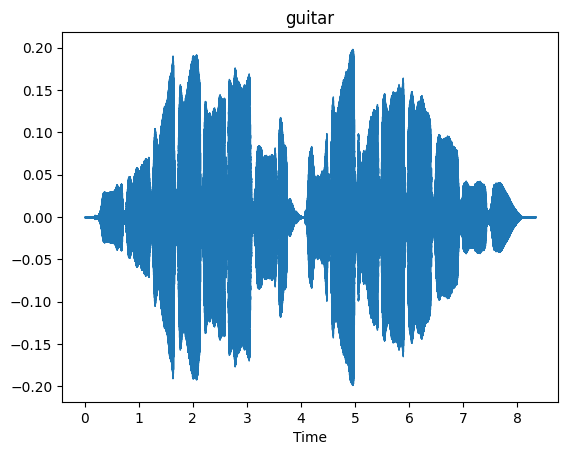

In [19]:
FRAME_LENGTH = 2048
HOP_LENGTH = 512
audio, _ = librosa.load(flute[1])
librosa.display.waveshow(audio)
plt.title(instrument_name[0])
ft = librosa.stft(audio)

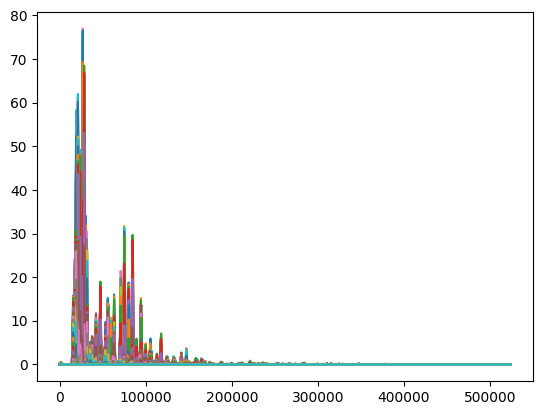

In [20]:
frame = range(len(ft))
freq = librosa.frames_to_samples(frame)
S = np.abs(ft)
# freq = range(sr)
plt.plot(freq, S)
plt.show()

In [21]:
plt.figure(figsize=(200, 80))

for i in range(len(instrument)):

    # signal, sr = librosa.load(instrument[i][1])
    plt.subplot(2, 5, i + 1)
    mel = librosa.feature.melspectrogram(y=signal[i], sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)
    log_mel = librosa.power_to_db(mel)
    librosa.display.specshow(data=log_mel, sr=sr, x_axis='time', y_axis='mel', n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)
    plt.title(instrument_name[i], fontdict={'fontsize': 100})
    plt.colorbar(format="%+2.2f")

# plt.tight_layout()
plt.show()

In [22]:
plt.figure(figsize=(200, 80))

for i in range(len(instrument)):

    # signal, sr = librosa.load(instrument[i][1])
    plt.subplot(2, 5, i + 1)
    mel = librosa.feature.melspectrogram(y=signal[i], sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)
    log_mel = librosa.power_to_db(mel)
    librosa.display.specshow(data=log_mel, sr=sr, x_axis='time', y_axis='mel', n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)
    plt.title(instrument_name[i], fontdict={'fontsize': 100})
    plt.colorbar(format="%+2.2f")

# plt.tight_layout()
plt.show()

In [23]:
plt.figure(figsize=(200, 80))

for i in range(len(instrument)):

    # signal, sr = librosa.load(instrument[i][1])
    plt.subplot(2, 5, i + 1)
    mfcc = librosa.feature.mfcc(y=signal[i], sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH, n_mels=40)
    # log_mfc/c = librosa.power_to_db(mfcc)
    librosa.display.specshow(data=mfcc, sr=sr, x_axis='time', y_axis='mel', n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)
    plt.title(instrument_name[i], fontdict={'fontsize': 100})
    plt.colorbar(format="%+2.2f")

# plt.tight_layout()
plt.show()

In [24]:
ipd.Audio(guitar[1], rate=44.1e3)

In [25]:
def amplitude_envelope(signal, frame_length, hop_length):
    return np.array([max(signal[i:i + frame_length]) for i in range(0, len(signal), hop_length)])

In [33]:
def plot_signal_feature(signal, frame_length, hop_length):
    plt.subplot(2, 2, 1)
    librosa.display.waveshow(signal, alpha=.5)

    envelope = amplitude_envelope(signal, frame_length, hop_length)
    frame = range(len(envelope))
    t = librosa.frames_to_time(frames=frame, hop_length=hop_length, n_fft=frame_length)
    plt.plot(t, envelope, color='r')

    rms = librosa.feature.rms(y=signal, frame_length=frame_length, hop_length=hop_length)[0]
    frame = range(len(rms))
    t = librosa.frames_to_time(frames=frame, hop_length=hop_length, n_fft=frame_length)
    plt.plot(t, rms, color='y')

    plt.title('Amplitude envelop & RMS')

    plt.subplot(2, 2, 2)
    zero_crossing_rate = librosa.feature.zero_crossing_rate(y=signal, frame_length=frame_length, hop_length=hop_length)[0]
    frame = range(len(zero_crossing_rate))
    t = librosa.frames_to_time(frames=frame, hop_length=hop_length, n_fft=frame_length)
    plt.plot(t, zero_crossing_rate, color='y')
    plt.title('Zero crossing Rate')

    plt.subplot(2, 2, 3)
    spectral_centroid = librosa.feature.spectral_centroid(y=signal, n_fft=frame_length, hop_length=hop_length)[0]
    frame = range(len(spectral_centroid))
    t = librosa.frames_to_time(frames=frame, hop_length=hop_length, n_fft=frame_length)
    plt.plot(t, spectral_centroid, color='g')
    plt.title('Spectral centroid')

    plt.subplot(2, 2, 4)
    spectral_bandwidth = librosa.feature.spectral_bandwidth(y=signal, n_fft=frame_length, hop_length=hop_length)[0]
    frame = range(len(spectral_bandwidth))
    t = librosa.frames_to_time(frames=frame, hop_length=hop_length, n_fft=frame_length)
    plt.plot(t, spectral_bandwidth, color='g')
    plt.title('Spectral brandwidth')

    plt.show()

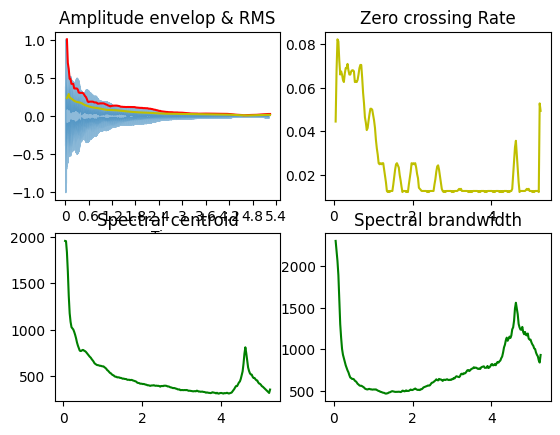

In [34]:
s, r = librosa.load(guitar[6])
# spectral_bandwidth = librosa.feature.spectral_bandwidth(y=s, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
# frame = range(len(spectral_bandwidth))
# t = librosa.frames_to_time(frames=frame, hop_length=HOP_LENGTH, n_fft=FRAME_LENGTH)
# plt.plot(t, spectral_bandwidth, color='g')
# plt.title('Spectral brandwidth')
plot_signal_feature(s, FRAME_LENGTH, HOP_LENGTH)

guitar


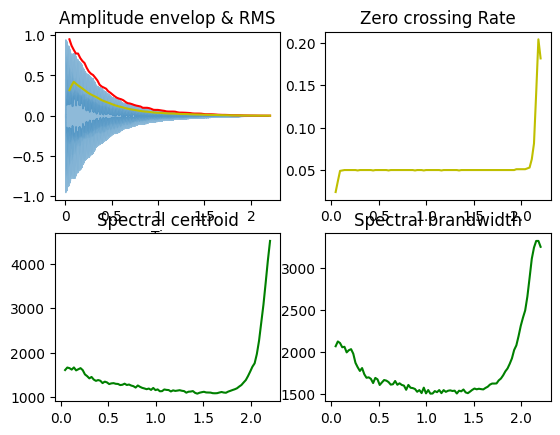

guitar


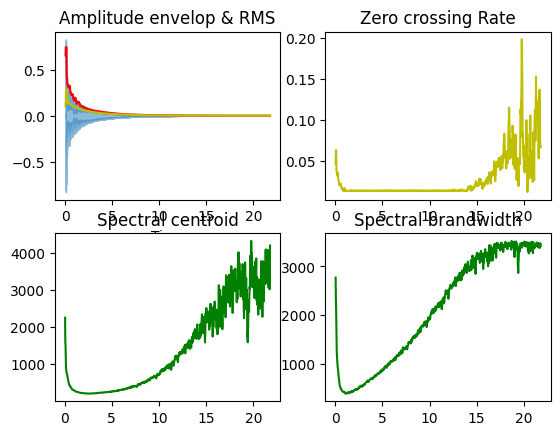

guitar


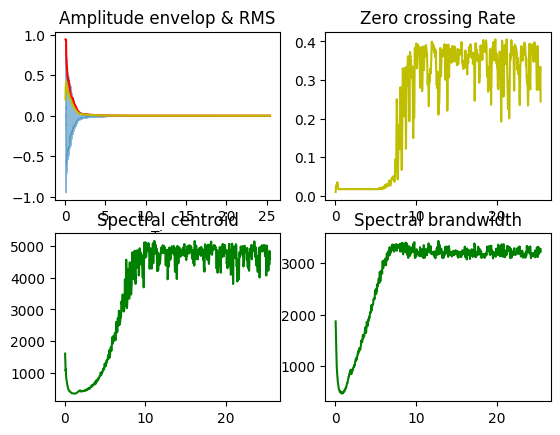

guitar


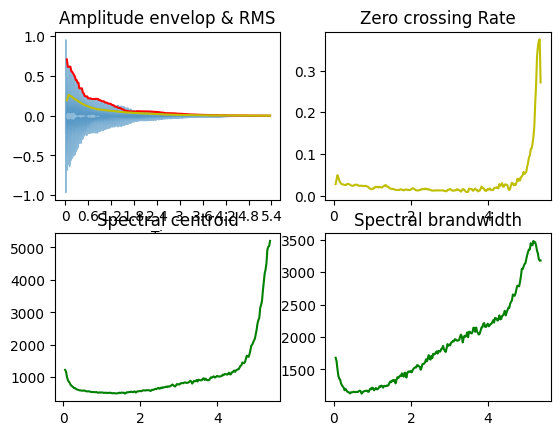

guitar


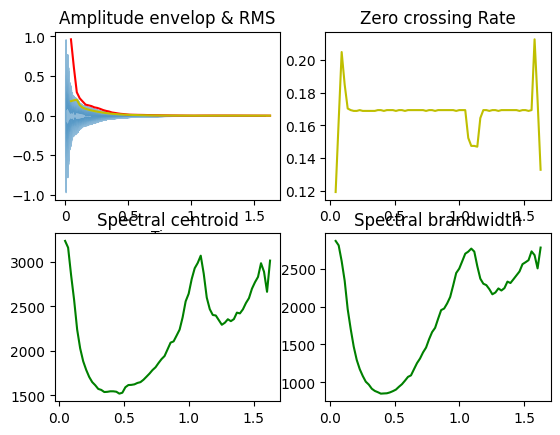

bass_drum


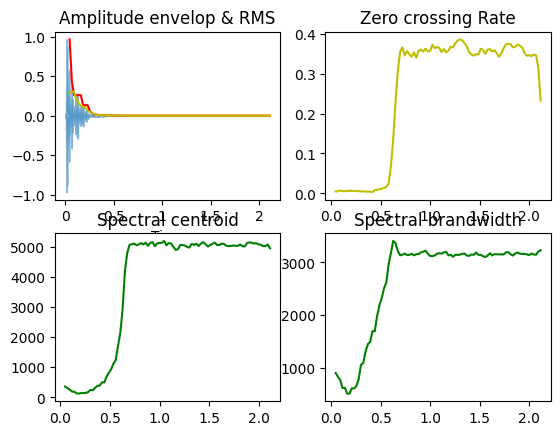

bass_drum


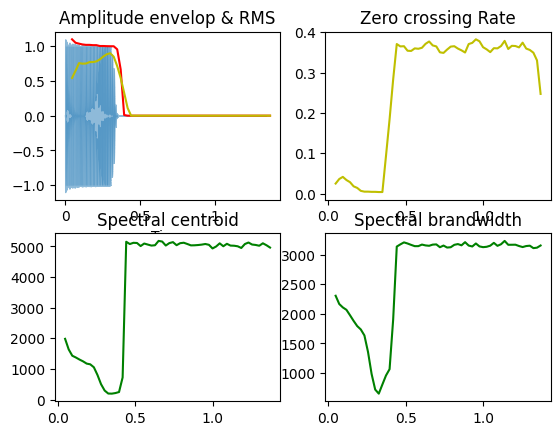

bass_drum


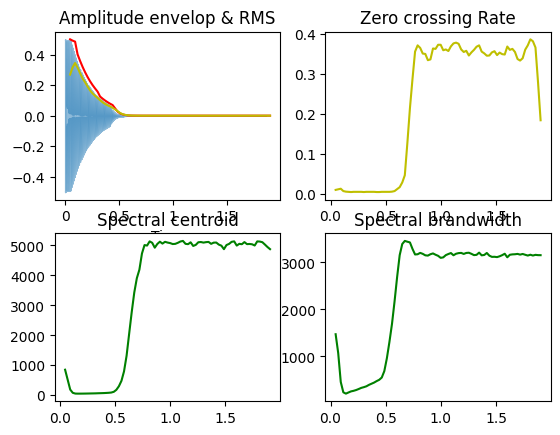

bass_drum


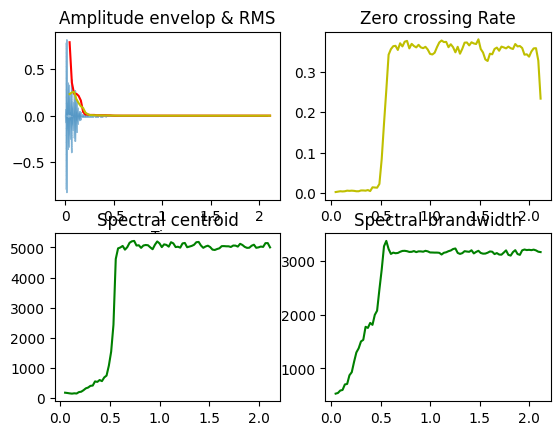

bass_drum


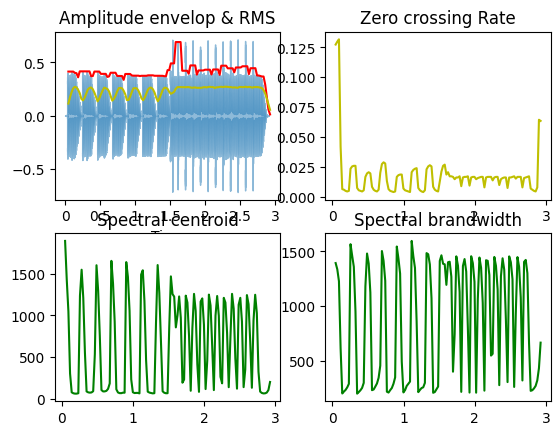

cello


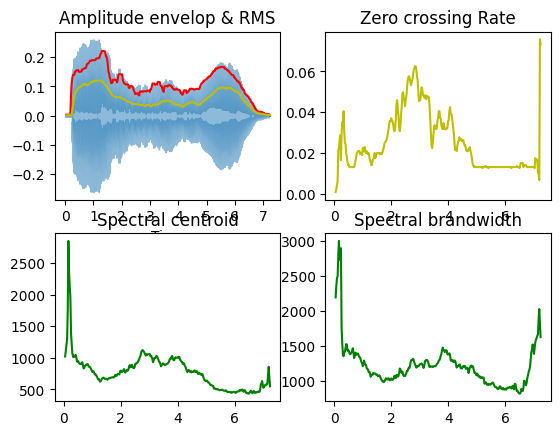

cello


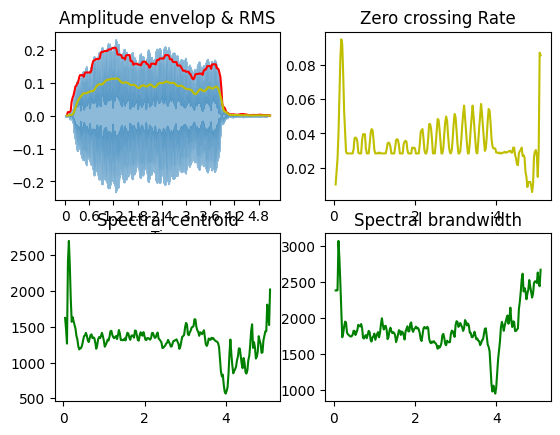

cello


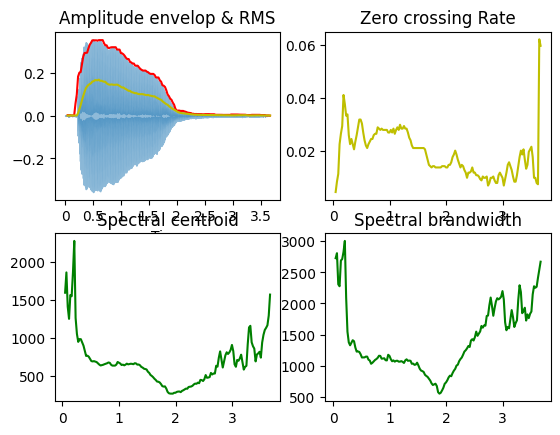

cello


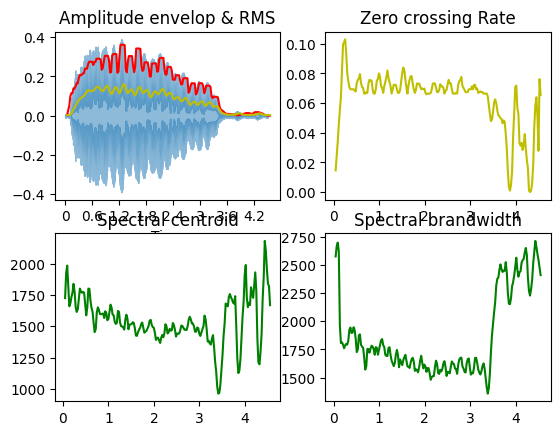

cello


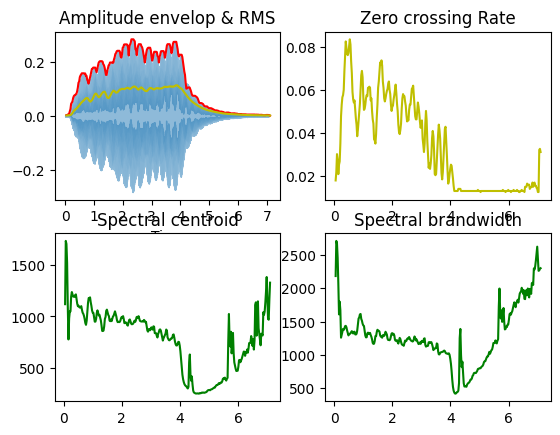

clarient


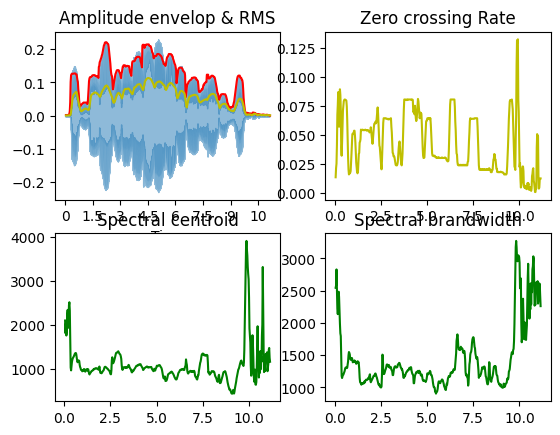

clarient


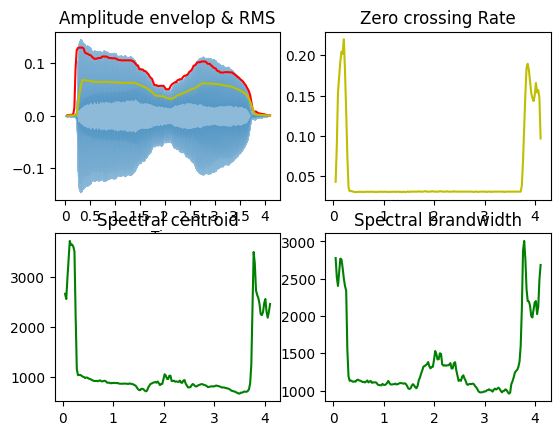

clarient


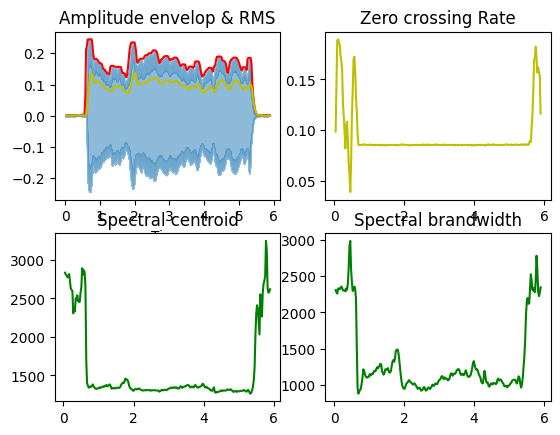

clarient


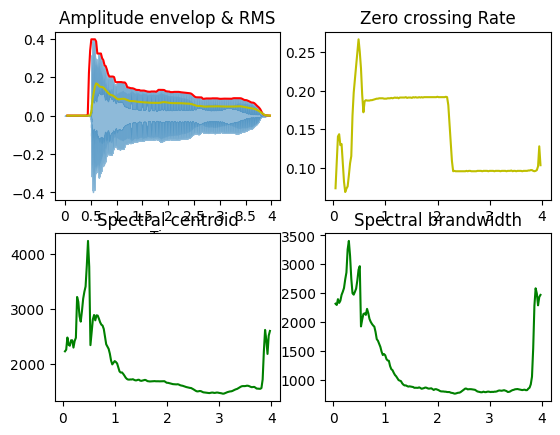

clarient


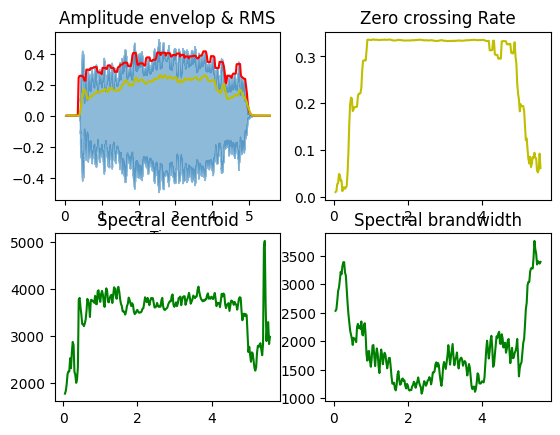

bass


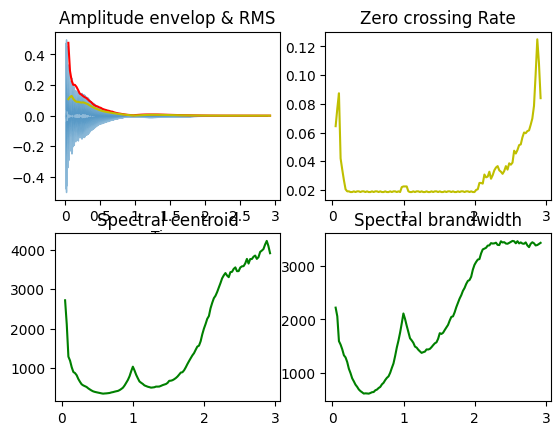

bass


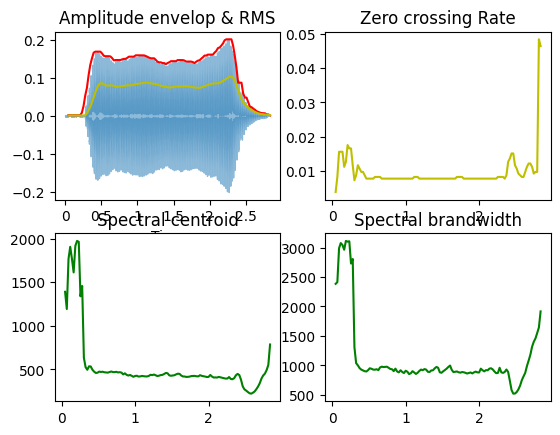

bass


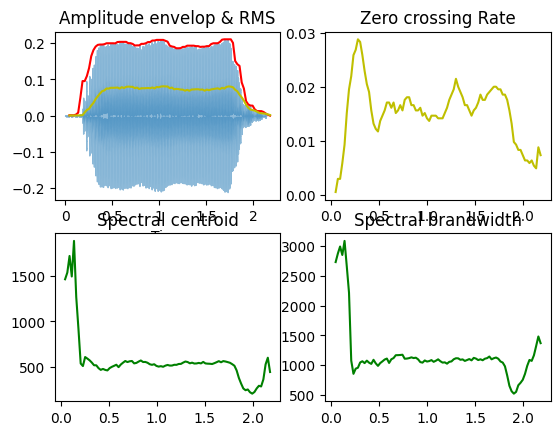

bass


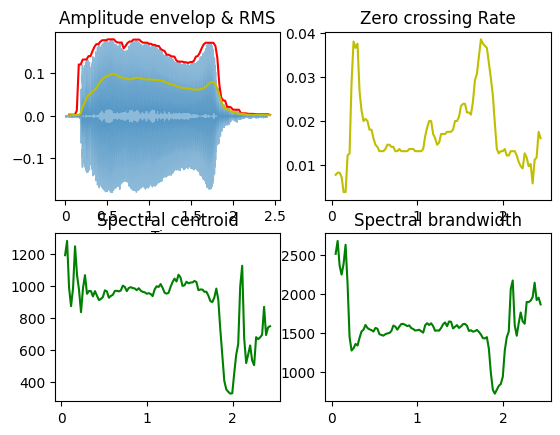

bass


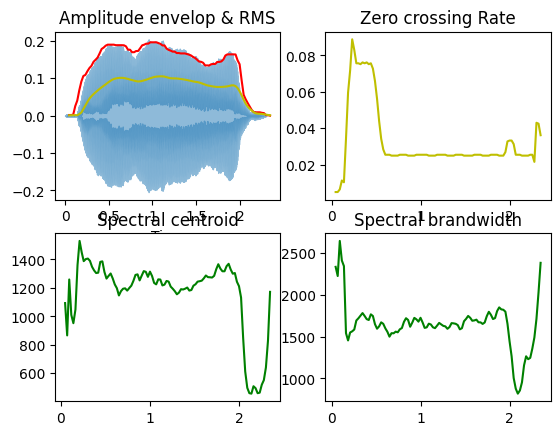

flute


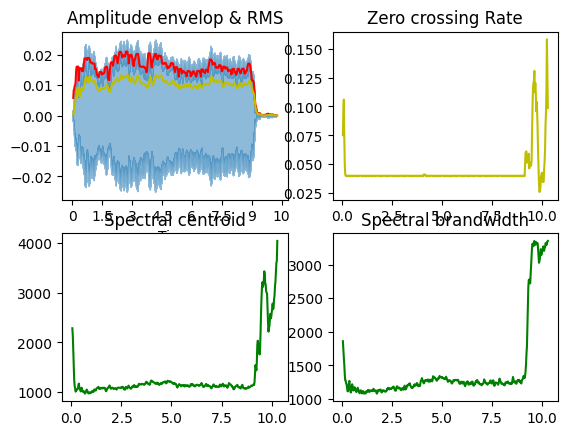

flute


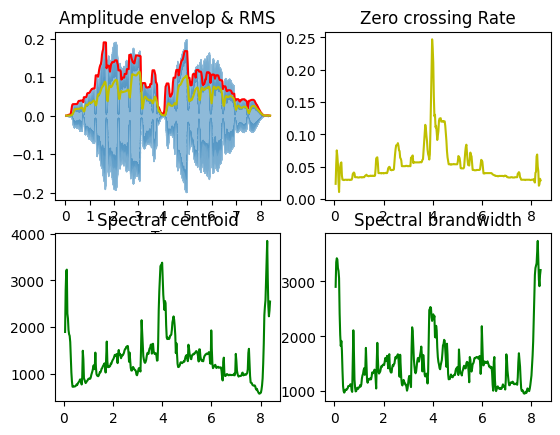

flute


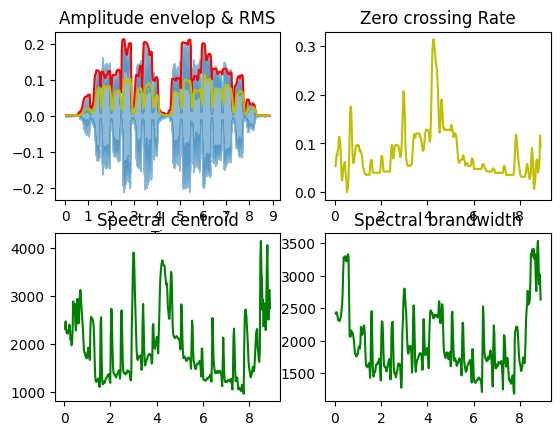

flute


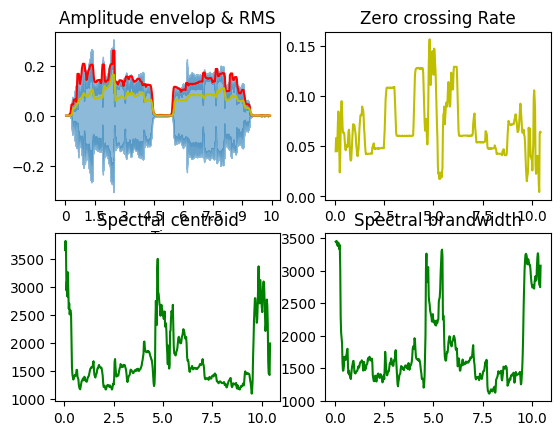

flute


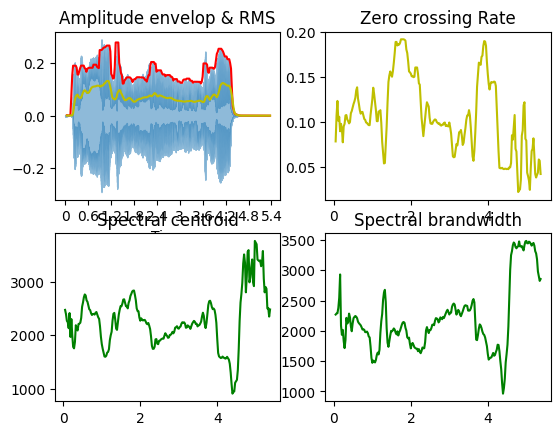

hi_hat


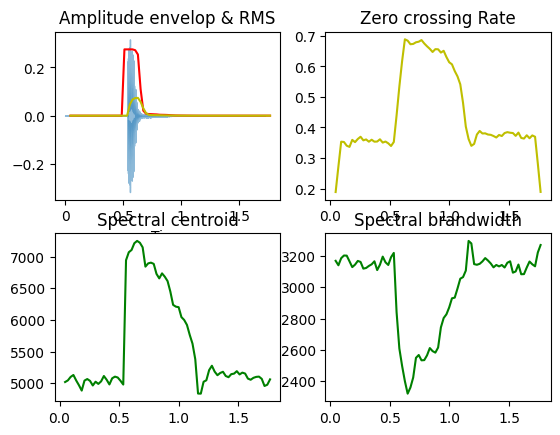

hi_hat


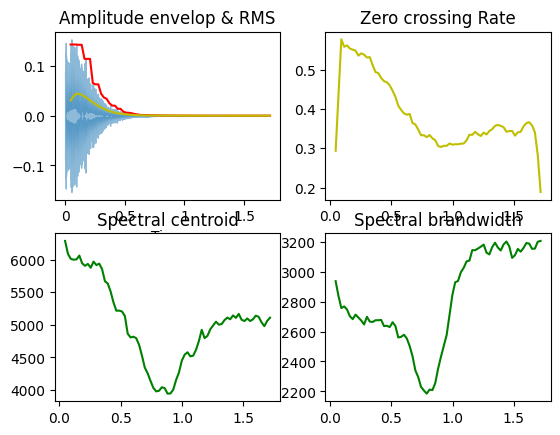

hi_hat


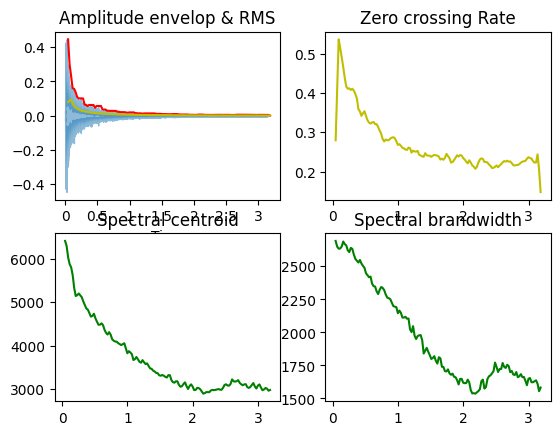

hi_hat


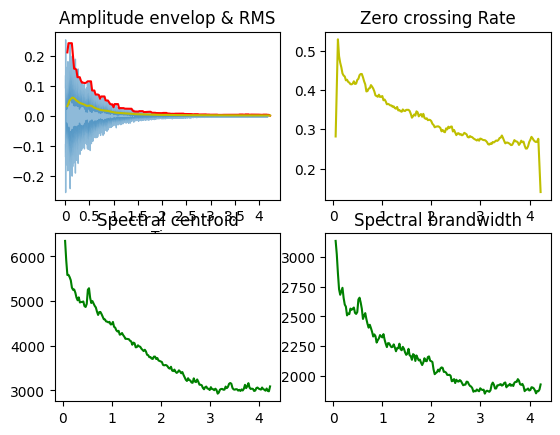

hi_hat


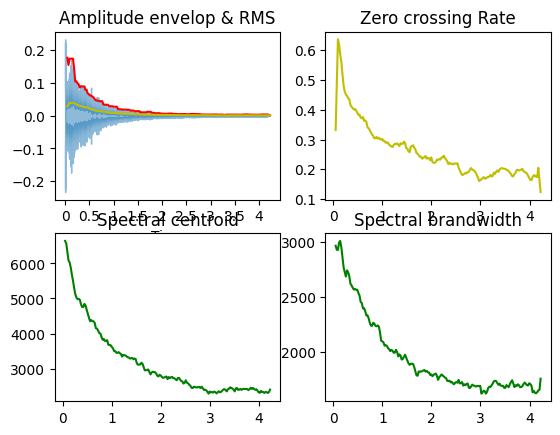

saxophone


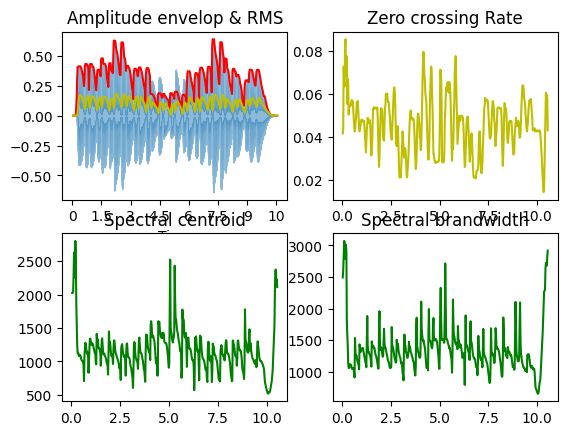

saxophone


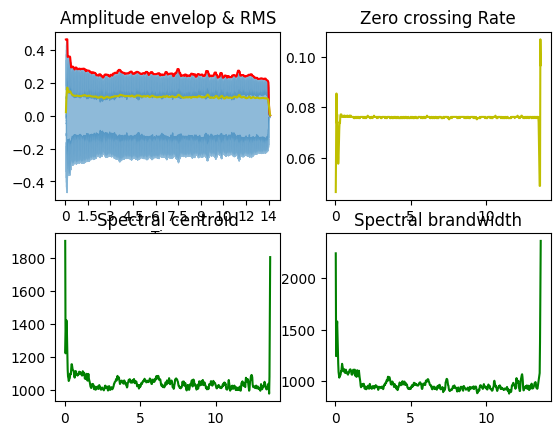

saxophone


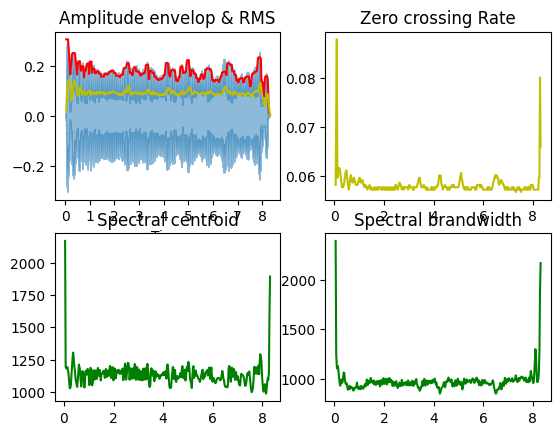

saxophone


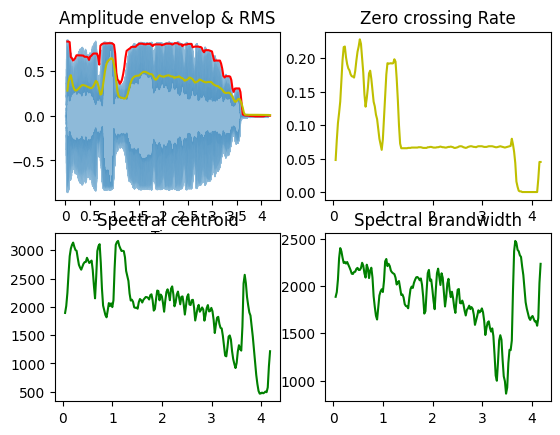

saxophone


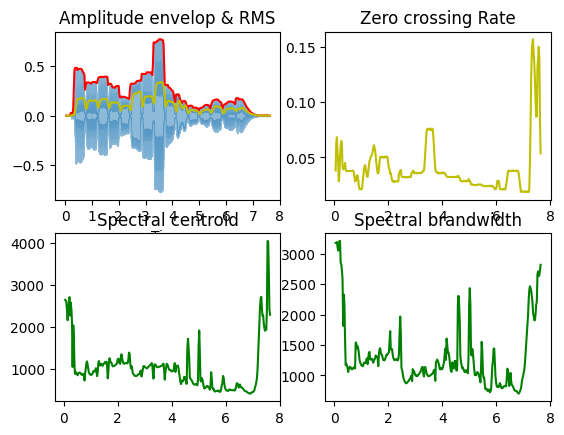

snare_drum


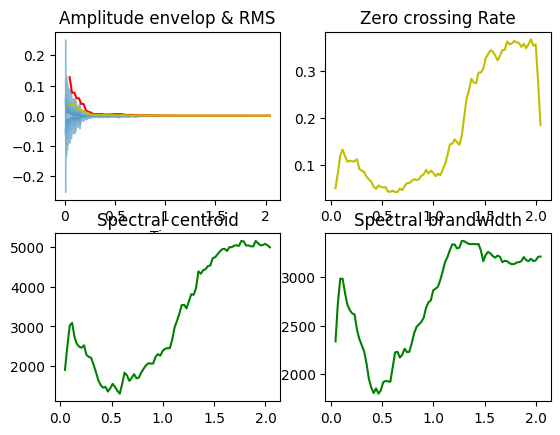

snare_drum


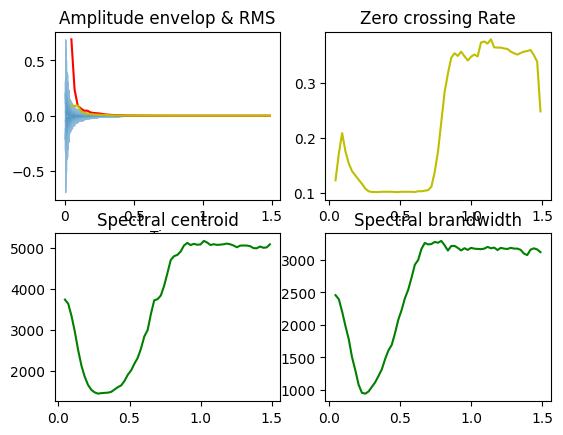

snare_drum


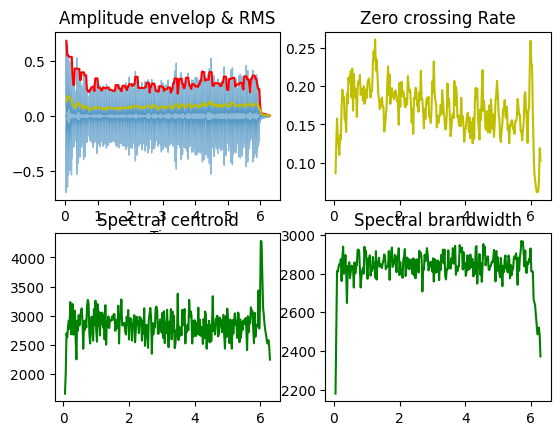

snare_drum


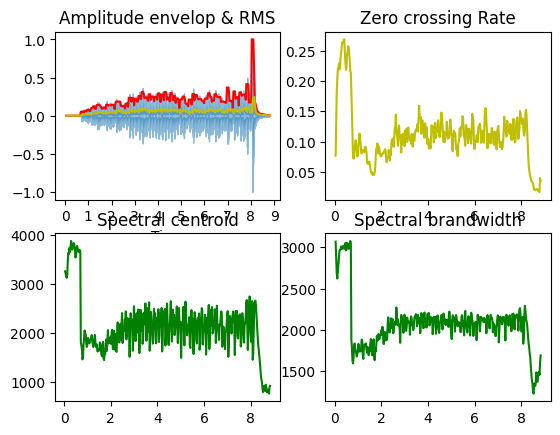

snare_drum


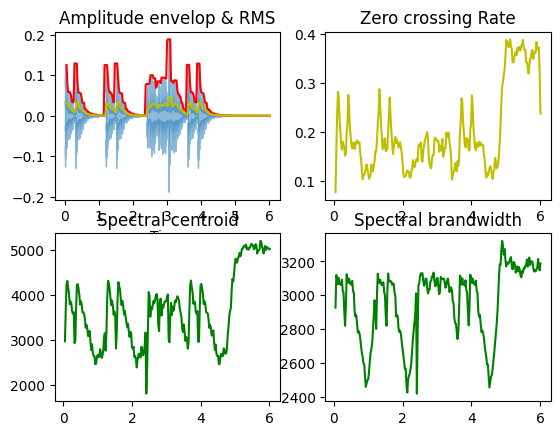

violin


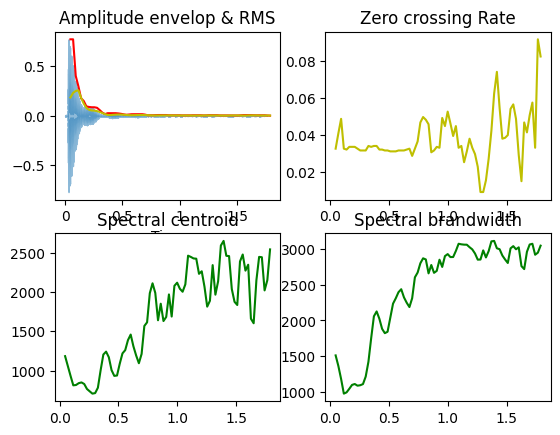

violin


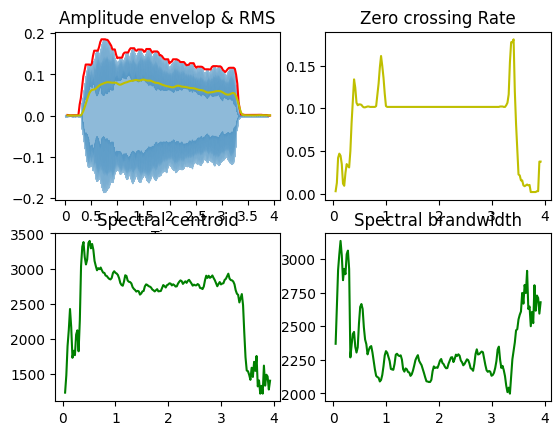

violin


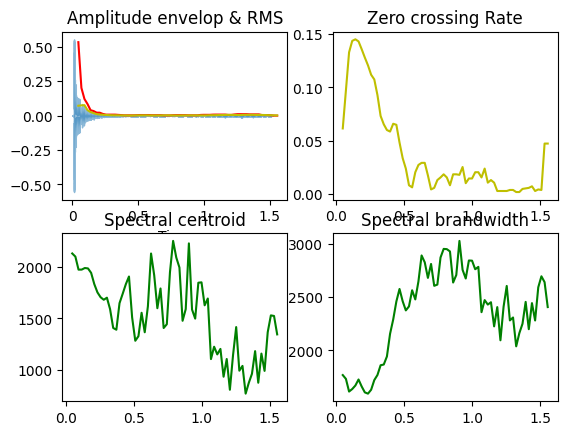

violin


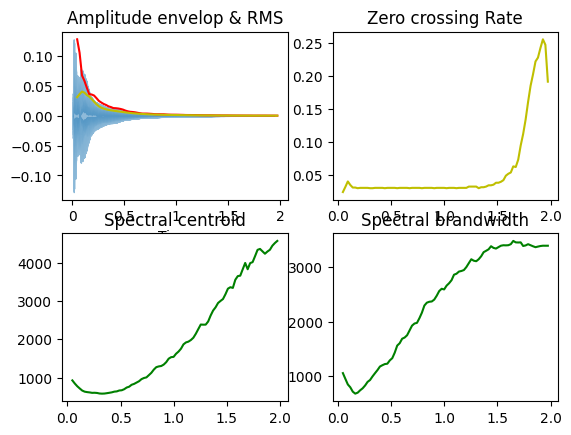

violin


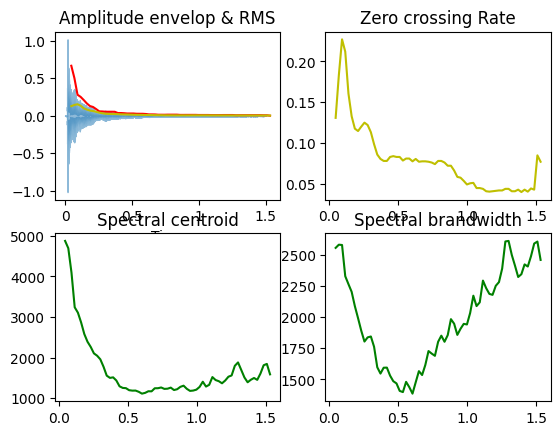

<Figure size 640x480 with 0 Axes>

In [35]:
for i in range(10):
    for j in range(5):
        print(instrument_name[i])
        s, r = librosa.load(instrument[i][j])
        plot_signal_feature(s, FRAME_LENGTH, HOP_LENGTH)
        plt.tight_layout()